<h1 style="font-size:30px;">Training a Deep Convolutional GAN</h1>

In this notebook, we will train a Deep Convolutional Generative Adversarial Neural Network (DCGAN) on complex RGB images. The general concept and GAN model is essentially the same as in the previous notebook. The only real difference is that the networks in this notebook use convolutional layers vs. fully connected layers. And we'll be using larger color images instead of smaller grayscale images. As a consequence, the time required to train the model will be much longer. 

<img src="https://opencv.org/wp-content/uploads/2022/09/c4-gan-dcgan-architecture.png" width=900>

## Table of Contents

* [1 Introduction to DCGANs and Why We Need Them](#1-Introduction-to-DCGANs-and-Why-We-Need-Them?)
* [2 System Configurations](#2-System-Configurations)
* [3 Training and Dataset Configurations](#3-Training-and-Dataset-Configurations)
* [4 Prepare the Dataset](#4-Prepare-the-Dataset)
* [5 The Generator Networks](#5-The-Generator-Network)
* [6 The Discriminator Networks](#6-The-Discriminator-Network)
* [7 Define the Loss Function](#7-Define-the-Loss-Function)
* [8 Define the Optimizers](#8-Define-the-Optimizers)
* [9 Checkpointing and Creating Directories](#9-Checkpointing-and-Creating-Directories)
* [10 Training](#10-Training)
* [11 Plot the Training Results](#11-Plot-the-Training-Results)
* [12 Create Images using the Trained Model](#12-Create-Images-using-the-Trained-Model)
* [13 Conclusion](#13-Conclusion)

In [ ]:
import os
import time
import numpy as np
import torch
import os
import matplotlib.pyplot as plt
import cv2
import requests
import zipfile
import torch.nn.functional as F

from dataclasses import dataclass
from matplotlib.ticker import (MultipleLocator, FormatStrFormatter)
from matplotlib import gridspec
from tqdm.auto import tqdm
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
from torch import (
    nn,
    optim
)

block_plot = False

## 1 Introduction to DCGANs and Why We Need Them

In the previous noteboook, we trained a Vanilla GAN (composed of fully connected layers only). We used the Fashion MNIST dataset, which are grayscale images. However, Vanilla GANs have their limitations. They don't work well on complex RGB (colored images). One of the reasons is that we flatten all the images for both, the generator and the discriminator. This leads to losing spatial information.

To solve this issue, we have Deep Convolutional GANs (DCGANs for short). As the name suggests, the DCGAN architecture is composed of convolutional layers. We already know the power of convolutional layers in capturing features in images. DCGANs were first introduced in the paper <a href="https://arxiv.org/pdf/1511.06434v2.pdf" target="_blank">Unsupervised Representation Learning with Deep Convolutional Generative Adversarial Networks</a> by Alec Radford et al.

### 1.1 The Generator
Let's take a look at the generator network.

<img src="https://opencv.org/wp-content/uploads/2022/09/c4-gan-dcgan-architecture.png">

As before, the generator network requires a latent noise vector as input. The rest of the network consists of convolutional layers where each subsequentlayer reduces the number of outputs channels from starting from 1024 down to 3 since the network needs to generate RGB color images (3 channels). Also, note that the sptial dimension at each layer continues to increase until the final layer has a spatial shape of 64x64. This means that the generator produces images of resolution 64x64x3 in the final layer. Recall from the Segmentation module, that upsampling like this is performed using transposed convolutions. 

### 1.2 The Discriminator

As before, the discriminator network is a binary classifier, but in this case, we are going to use convolutional layers much like all the other CNN classifiers we have demonstrated in the course. However, there are a few things that are a bit different from other CNNs we have used. For example, we do not use any 2D Max-Pooling layers in the discriminator and we use strided convolution (stride > 1) to keep reducing the feature map sizes. 

### 1.3 Architecture Guidelines for Stable DCGAN Training

There are a few important guidelines that the authors recommend after extensive experiments with DCGAN architectures. We will also follow these guidelines in this notebook while building the generator and discriminator architectures.

<img src="https://opencv.org/wp-content/uploads/2022/09/c4-gan-dcgan-training-guideline.png" width=650>



## 2 System Configurations

In [ ]:
def set_seed(SEED_VALUE):
    torch.manual_seed(SEED_VALUE)
    torch.cuda.manual_seed(SEED_VALUE)
    torch.cuda.manual_seed_all(SEED_VALUE)
    np.random.seed(SEED_VALUE)
    
seed = 7
set_seed(seed)

## 3 Training and Dataset Configurations

The original DCGAN paper uses a 100-dimensional noise vector. However, from the experiments we conducted, we found that a slightly higher dimensional noise vector (`LATENT_DIM: int = 128`) performs better on complex datasets such as the one we will use here. 

In [ ]:
@dataclass(frozen=True)
class TrainingConfig:
    DEVICE: torch.device = 'cuda:0' if torch.cuda.is_available() else 'cpu'
    NUM_EPOCHS: int = 31
    LATENT_DIM: int = 128
    BATCH_SIZE: int = 16
    LEARNING_RATE_D: float = 0.0002
    LEARNING_RATE_G: float = 0.0002
    CHECKPOINT_DIR: str = os.path.join('model_checkpoint', 'dcgan_flickr_faces')
        
class DatasetConfig:
    IMG_HEIGHT:   int = 64
    IMG_WIDTH:    int = 64
    NUM_CHANNELS: int = 3

## 4 Prepare the Dataset

We will be using the Flickr Faces dataset here, which contains 70,000 images of faces. We have taken the dataset from <a href="https://www.kaggle.com/datasets/xhlulu/flickrfaceshq-dataset-nvidia-resized-256px" target="_blank">Kaggle</a>. The images of the faces have already been resized to 256x256 resolution. But we will further resize them to 64x64 resolution for GAN training.

**Note**: This is a large dataset containing 70,000 images (2 GB in size). It is much better to run the notebook on either Kaggle kernel or Google Colab with GPU. You may also run it locally if you have a reasonably powerful GPU.

In [ ]:
def download_file(url, save_name):
    url = url
    if not os.path.exists(save_name):
        file = requests.get(url)
        open(save_name, 'wb').write(file.content)

In [ ]:
def unzip(zip_file=None):
    try:
        with zipfile.ZipFile(zip_file) as z:
            z.extractall("dataset_flickr_faces")
            print("Extracted all")
    except:
        print("Invalid file")

In [ ]:
download_file(
    'https://www.dropbox.com/s/crg8qvtix3wg6kx/dataset_flickr_faces.zip?dl=1',
    'dataset_flickr_faces.zip'
)
    
unzip(zip_file='dataset_flickr_faces.zip')

Extracted all


The following `transform` will resize the images to 64x64 resolution, convert them into tensors, and normalize the pixel values to be in the range [-1, 1].

In [ ]:
# Tranforms to resize and convert the pixels between -1 and 1.
transform = transforms.Compose([
    transforms.Resize((DatasetConfig.IMG_HEIGHT, DatasetConfig.IMG_WIDTH)),
    transforms.ToTensor(),
    transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
])

Here, we can use the `ImageFolder` class to easily create the dataset. But this required the images to be in a subdirectory. So, we extract the images in a `dataset_flickr_faces` subdirectory.

In [ ]:
# Prepare the dataset.
dataset_train = datasets.ImageFolder(
    root='dataset_flickr_faces/',
    transform=transform
)

The following code block displays a few of the images from the dataset.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  # This is added back by InteractiveShellApp.init_path()


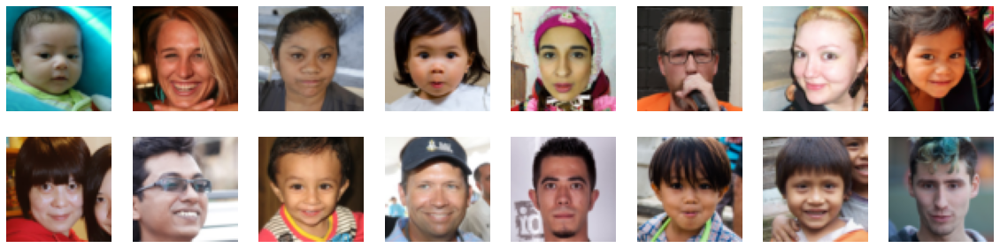

In [ ]:
# Visualize a few images.
plt.figure(figsize=(20, 5))

for image in range(TrainingConfig.BATCH_SIZE):
    
    nrow = 2
    ncol = min(8, int(TrainingConfig.BATCH_SIZE/nrow))
    
    for i in range(nrow*ncol):
        image = dataset_train[i][0] / 2 + 0.5 
        ax = plt.subplot(nrow, ncol, i + 1)
        plt.imshow(image.permute(1, 2, 0))
        plt.axis("off")

In [ ]:
# The data loader.
train_dataloader = DataLoader(
    dataset=dataset_train,
    batch_size=TrainingConfig.BATCH_SIZE,
    shuffle=True,
    num_workers=4
)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


## 5 The Generator Network

While building the generator model, we will try to follow the original structure as closely as possible. A 128-dimensional normal distribution is projected to a small spatial extent convolutional representation with many feature maps. A series of four transposed convolutions then convert this high level representation into a 64x64 pixel image.

We start with the 1024-dimensional tranposed convolutional layer and finish with a 64-dimensional layer. The output layer should generate RGB images. So, it has 3 channels. Note that the outputs of the final transposed convolutional layer are fed to a Tanh activation which is important for generating good results.

In the first trasposed convolutional layer, we use a kernel size of 4 and stride of 4. This outputs a 4x4x1024 feature map. In all of the subsequent trasnposed convolutional layers, we use stride of 2. This upsamples the feature map two times in each of the blocks. As a result, the *generator model outputs a 64x64x3 image in the final layer.   

The implementation of the generator here is exactly the same as in the original DCGAN paper except for the latent dimension. As discussed earlier, we will be using a 128-dimensional noise vector as input to the generator instead of a 100-dimensional noise vector.

In [ ]:
class Generator(nn.Module):
    def __init__(self, latent_dim):
        super(Generator, self).__init__()
        self.nz = latent_dim
        self.generator = nn.Sequential(
            nn.ConvTranspose2d(
                self.nz, 1024, kernel_size=4,
                stride=4, padding=1 
            ),
            nn.BatchNorm2d(1024),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(
                1024, 512, kernel_size=4,
                stride=2, padding=1 
            ),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(
                512, 256, kernel_size=4,
                stride=2, padding=1 
            ),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(
                256, 128, kernel_size=4,
                stride=2, padding=1 
            ),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(
                128, 64, kernel_size=4,
                stride=2, padding=1 
            ),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(
                64, 3, kernel_size=4,
                stride=2, padding=1 
            ),
            nn.Tanh()
        )
    
    def forward(self, input):
        return self.generator(input)

In [ ]:
generator = Generator(TrainingConfig.LATENT_DIM).to(TrainingConfig.DEVICE)
print(generator)
# Total parameters and trainable parameters.
total_params = sum(p.numel() for p in generator.parameters())
print(f"{total_params:,} total parameters.")
total_trainable_params = sum(
    p.numel() for p in generator.parameters() if p.requires_grad)
print(f"{total_trainable_params:,} training parameters.")

Generator(
  (generator): Sequential(
    (0): ConvTranspose2d(128, 1024, kernel_size=(4, 4), stride=(4, 4), padding=(1, 1))
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (13): BatchNorm2d(64, eps=1e-05, momentum=0.1, affi

## 6 The Discriminator Network

As you can see, we have a pretty big generation model (more than 13 million parameters) by following the guidelines of the authors. We will also need a reasonably large discriminator model to match the capacity of the generator. Otherwise, the generator will be able to the fool the discriminator very easily, and the GAN training may not be successful. 

In the DCGAN paper, the authors don't provide any specific output dimensions for the 2D convolutional layers for the discriminator model. So, we choose them ourselves while following the architectural guidelines as proposed by the authors.

* No batch normalization layer after the input layer
* Using Leaky ReLU instead of ReLU activation

The discriminator model has a normal convolutional layer followed by three convolutional
layers using a stride of 2 × 2 to downsample the input image. The model has no pooling layers
and a single node in the output layer with the sigmoid activation function to predict whether
the input sample is real or fake. The model is trained to minimize the binary cross-entropy
loss function, appropriate for binary classification. We will use some best practices in defining
the discriminator model, such as the use of LeakyReLU instead of ReLU, using Dropout, and
using the Adam version of stochastic gradient descent with a learning rate of 0.0002 and a
momentum of 0.5. The `Discriminator()` class below defines the discriminator
model and parametrizes the size of the input image.

In [ ]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
                
        self.conv_layers = nn.Sequential(
            nn.Conv2d(
                3, 64, kernel_size=4, stride=2, padding=1
            ),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(
                64, 128, kernel_size=4, stride=2, padding=1
            ),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(
                128, 256, kernel_size=4, stride=2, padding=1
            ),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(
                256, 512, kernel_size=4, stride=2, padding=1
            ),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(
                512, 1024, kernel_size=4, stride=2, padding=1
            ),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(
                1024, 1, kernel_size=3, stride=4, padding=1
            )
        )
        
        self.linear_layers = nn.Sequential(
            nn.Linear(1, 1),
            nn.Sigmoid()
        )
        
    def forward(self, x):
        x = self.conv_layers(x)
        bs, _, _, _ = x.shape
        x = F.adaptive_avg_pool2d(x, 1).reshape(bs, -1)
        x = self.linear_layers(x)
        return x

In [ ]:
discriminator = Discriminator().to(TrainingConfig.DEVICE)
print(discriminator)
# Total parameters and trainable parameters.
total_params = sum(p.numel() for p in discriminator.parameters())
print(f"{total_params:,} total parameters.")
total_trainable_params = sum(
    p.numel() for p in discriminator.parameters() if p.requires_grad)
print(f"{total_trainable_params:,} training parameters.")

Discriminator(
  (conv_layers): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2)
    (11): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (12): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (13): LeakyReLU(negative_slope=0.2)
    (14): Conv

## 7 Define the Loss Function

Here we use the same Binary Cross Entropy loss function as we did in the previous notebook.

In [ ]:
BCE = nn.BCELoss()

In [ ]:
def loss_func(y_true, y_pred):
    loss = BCE(y_pred, y_true)
    return loss

## 8 Define the Optimizers

Here, we use the Adam optimizer for both networks and the same optimizer settings as in the previous notebook which are known to work well for many applications.

In [ ]:
optimizer_G = optim.Adam(
    generator.parameters(), 
    lr=TrainingConfig.LEARNING_RATE_G,
    betas=(0.5, 0.999)
)
optimizer_D = optim.Adam(
    discriminator.parameters(), 
    lr=TrainingConfig.LEARNING_RATE_D,
    betas=(0.5, 0.999)
)

## 9 Checkpointing and Creating Directories

In [ ]:
if not os.path.exists(TrainingConfig.CHECKPOINT_DIR):
    os.makedirs(TrainingConfig.CHECKPOINT_DIR)
    
num_versions = len(os.listdir(TrainingConfig.CHECKPOINT_DIR)) + 1
ckpt_version_dir = TrainingConfig.CHECKPOINT_DIR + '/version_' + str(num_versions)
os.makedirs(ckpt_version_dir)

In [ ]:
checkpoint_dir = TrainingConfig.CHECKPOINT_DIR
generator_ckpt = os.path.join(ckpt_version_dir, 'generator'+'.pth')
discriminatr_ckpt = os.path.join(ckpt_version_dir, 'discriminator'+'.pth')

## 10 Training

In the previous notebook, we created two separate train step functions (one for the discriminator and one for the generator). We did this intentionally to isolate the training steps for each network so that it would be more clear how each network is trained. However, that implementation is not efficient since it requires two separate calls to the generator for each training step. In the implementation below, we create a single `train_step()` function that performs the sequential training of both networks. Also, one thing to notice is that the noise vector is now 4-dimensional.

### 10.1 `train_step()` Function

In [ ]:
def train_step(real_images):
    optimizer_G.zero_grad()
    optimizer_D.zero_grad()
    # Create ground truth labels for real and fake data.
    labels = torch.cat(
        (
            torch.ones(TrainingConfig.BATCH_SIZE, 1), # Labels for real data
            torch.zeros(TrainingConfig.BATCH_SIZE, 1) # Labels for fake data
        ), dim=0
    ).to(TrainingConfig.DEVICE)
    
    # We want to fool the discriminator, so we create grond truth labels for 
    # real images even though we feed the discriminator with fake images.
    misleading_labels = torch.ones(
        TrainingConfig.BATCH_SIZE, 1
    ).to(TrainingConfig.DEVICE)
    
    noise = torch.randn(
        TrainingConfig.BATCH_SIZE, 
        TrainingConfig.LATENT_DIM,
        1, 1
    ).to(TrainingConfig.DEVICE)
    
    #----------------------------------------------------------------
    # First, generate fake images needed for training both networks.
    #----------------------------------------------------------------
    # Generate fake images.
    fake_images = generator(noise)
    
    # Predicted labels from discriminator for real images.
    y_pred_real = discriminator(real_images)
    
    # Predicted labels from discriminator for fake images.
    y_pred_fake = discriminator(fake_images)
    
    # Concatenate predictions for real and fake input data.
    y_pred_D = torch.cat((
        y_pred_real, y_pred_fake
    ), dim=0)
    
    # Compute the discriminator loss.
    D_loss = loss_func(labels, y_pred_D)
        
    # Discriminator step.
    D_loss.backward()
    optimizer_D.step()
    
    # Generate fake images.
    fake_images = generator(noise)
    
    # Predicted labels from discriminator for fake images.
    y_pred_fake = discriminator(fake_images)
    
    # Compute the generator loss.
    G_loss = loss_func(misleading_labels, y_pred_fake)
    
    # Generator step.
    G_loss.backward()
    optimizer_G.step()
    
    return D_loss, G_loss

### 10.2 ` plot_images()` Convenience Function

In [ ]:
# Create `BATCH_SIZE` fixed noise vector for generating examples images during training.
fixed_noise = torch.randn(
        TrainingConfig.BATCH_SIZE, 
        TrainingConfig.LATENT_DIM,
        1, 1)
    
def plot_images(model):
    
    model.eval()
    with torch.no_grad():
        images = model(fixed_noise.to(TrainingConfig.DEVICE))
        images = images.detach().cpu()

    plt.figure(figsize=(20, 4))

    nrow = 2
    ncol = int(images.shape[0] / nrow)
    
    for i, image in enumerate(images):
        col = int(TrainingConfig.BATCH_SIZE / 2)
        plt.subplot(nrow, ncol, i+1)
        image = (image.permute(1, 2, 0).squeeze(0) + 1) * 127.5
        plt.imshow(np.array(image).astype('uint8'))
        plt.axis('off')
        
    plt.show();

### 10.3 `train()` Function

In [ ]:
G_LOSS = []
D_LOSS = []

def train(dataloader, epochs):
    for epoch in range(epochs):
        generator.train()
        discriminator.train()
        start = time.time()
        i = 0
        D_loss_list, G_loss_list = [], []
        
        for bi, data in tqdm(enumerate(dataloader), total=int(len(dataloader))):
            image_batch, _ = data
            image_batch = image_batch.to(TrainingConfig.DEVICE)
            
            i += 1
            
            D_loss, G_loss = train_step(image_batch)
            
            D_loss_list.append(D_loss)
            G_loss_list.append(G_loss)
            
        if (epoch + 1) % 5 == 0:
            torch.save(generator, generator_ckpt)
            torch.save(discriminator, discriminatr_ckpt)
            
        epoch_D_loss = sum(D_loss_list)/len(D_loss_list)
        epoch_G_loss = sum(G_loss_list)/len(G_loss_list)

        D_LOSS.append(epoch_D_loss.detach().cpu())
        G_LOSS.append(epoch_G_loss.detach().cpu())
        
        print('\n')
        print(f"Time for epoch {epoch + 1} is {time.time()-start} sec")
        print(f"Generator loss: {epoch_G_loss:.3f}, Discriminator loss: {epoch_D_loss:.3f}")

        plot_images(generator)     

### 10.4 Train the GAN

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 1 is 221.51155400276184 sec
Generator loss: 5.290, Discriminator loss: 0.283


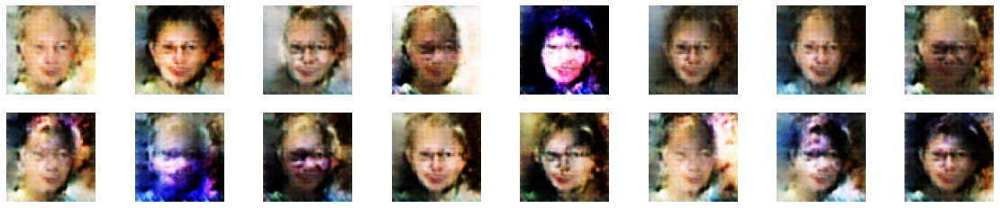

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 2 is 217.95820260047913 sec
Generator loss: 6.582, Discriminator loss: 0.212


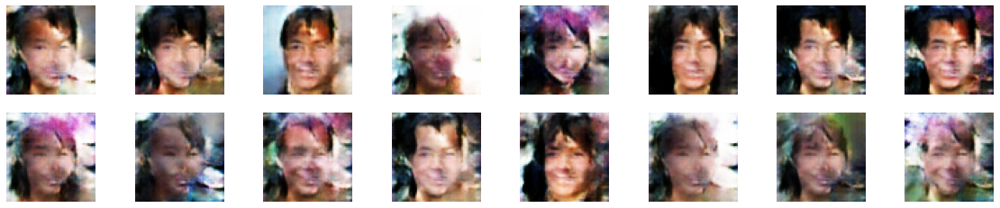

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 3 is 221.33882093429565 sec
Generator loss: 7.107, Discriminator loss: 0.167


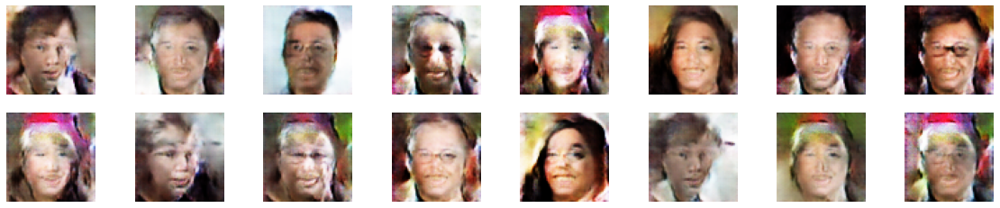

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 4 is 226.68278002738953 sec
Generator loss: 7.129, Discriminator loss: 0.150


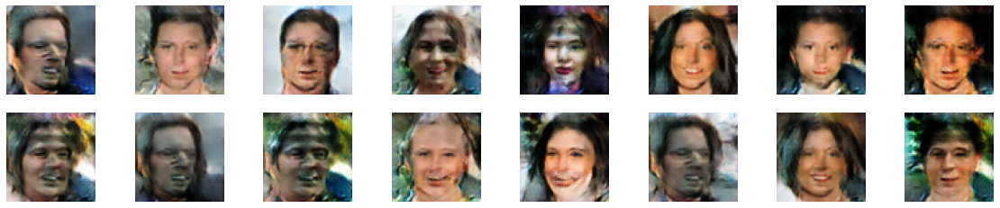

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 5 is 228.61834120750427 sec
Generator loss: 6.952, Discriminator loss: 0.145


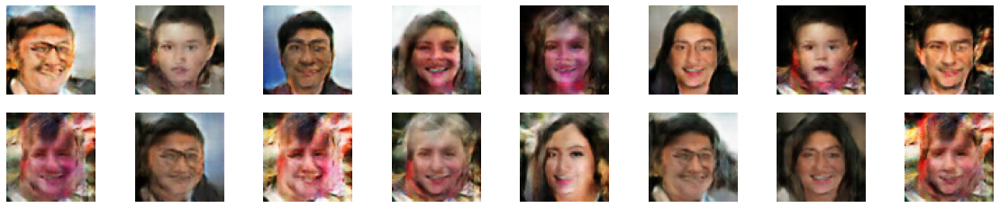

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 6 is 234.84391236305237 sec
Generator loss: 6.922, Discriminator loss: 0.140


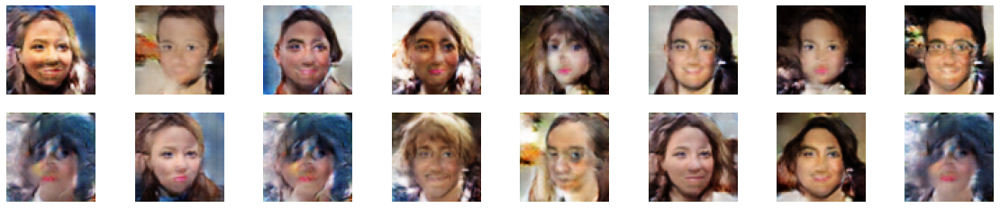

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 7 is 245.4100480079651 sec
Generator loss: 6.918, Discriminator loss: 0.139


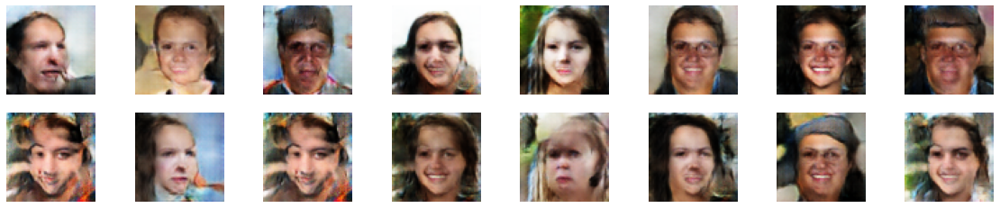

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 8 is 253.10367393493652 sec
Generator loss: 6.810, Discriminator loss: 0.138


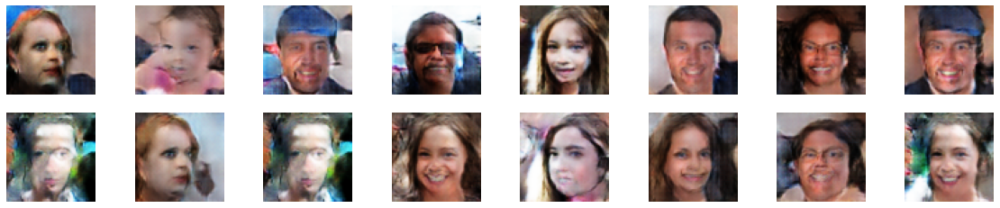

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 9 is 265.68075680732727 sec
Generator loss: 6.751, Discriminator loss: 0.137


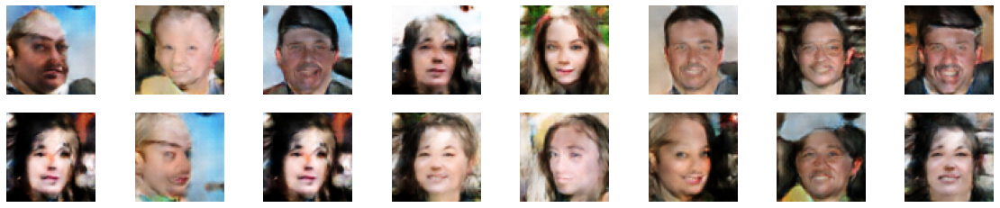

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 10 is 276.1045141220093 sec
Generator loss: 6.792, Discriminator loss: 0.131


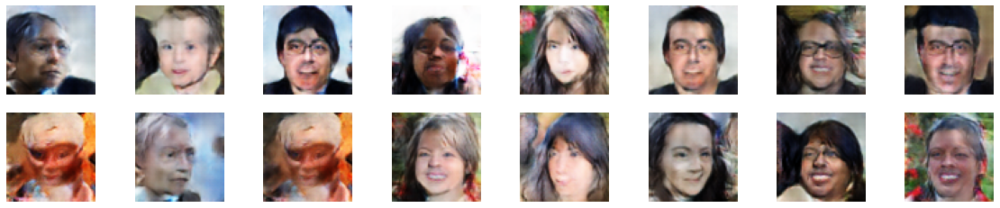

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 11 is 285.31116819381714 sec
Generator loss: 6.758, Discriminator loss: 0.128


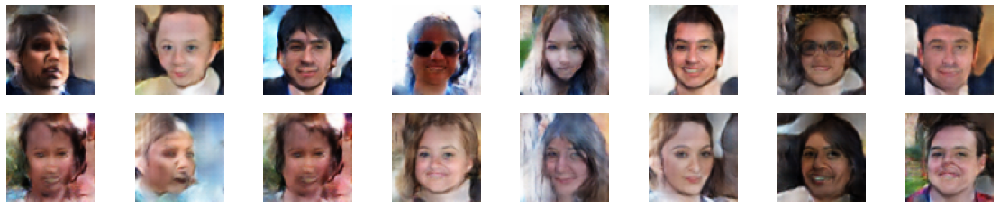

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 12 is 297.1011881828308 sec
Generator loss: 6.800, Discriminator loss: 0.124


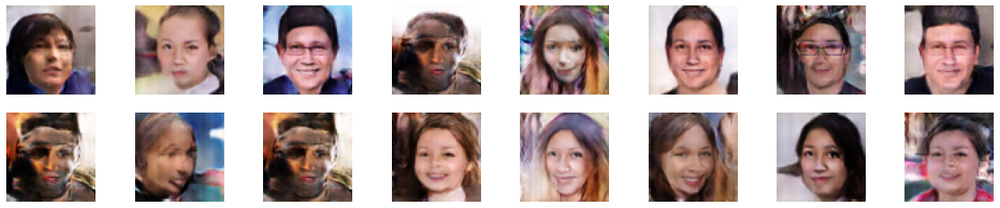

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 13 is 303.5572826862335 sec
Generator loss: 6.876, Discriminator loss: 0.119


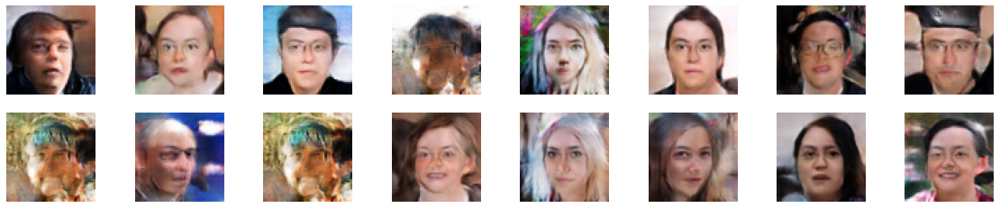

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 14 is 304.05386185646057 sec
Generator loss: 7.012, Discriminator loss: 0.113


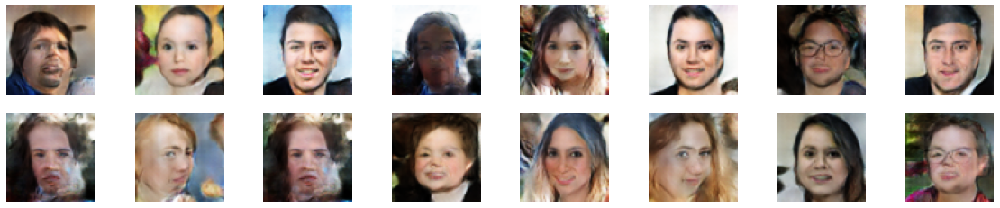

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 15 is 308.185005903244 sec
Generator loss: 7.109, Discriminator loss: 0.111


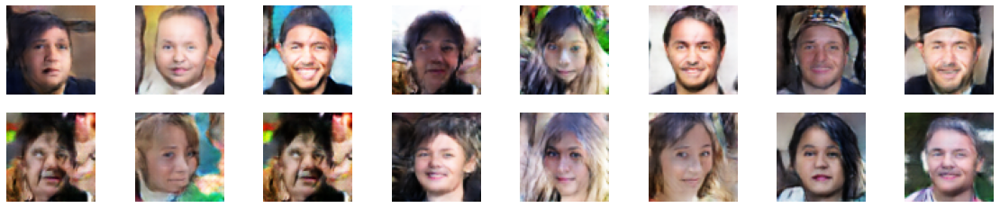

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 16 is 308.06803131103516 sec
Generator loss: 7.158, Discriminator loss: 0.108


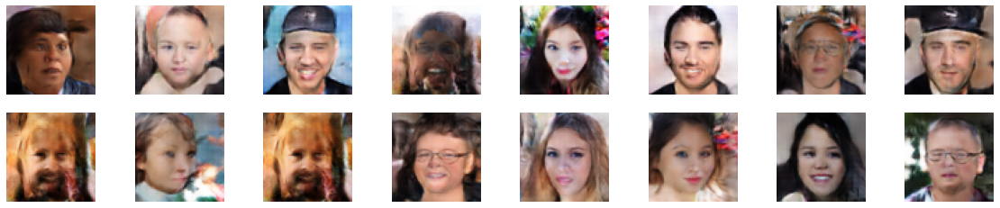

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 17 is 307.51840591430664 sec
Generator loss: 7.093, Discriminator loss: 0.109


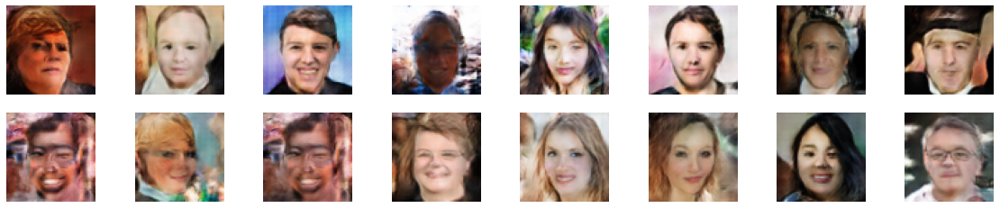

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 18 is 308.7669336795807 sec
Generator loss: 7.163, Discriminator loss: 0.102


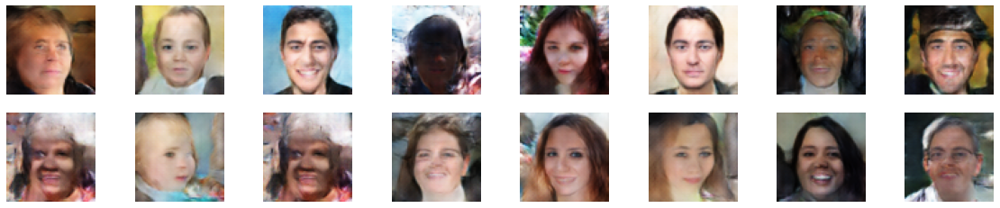

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 19 is 307.88123178482056 sec
Generator loss: 7.315, Discriminator loss: 0.098


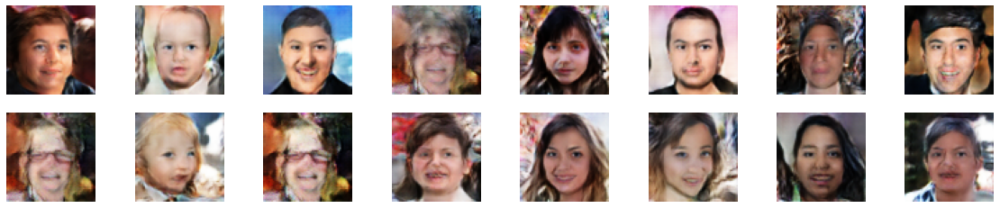

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 20 is 309.5389823913574 sec
Generator loss: 7.504, Discriminator loss: 0.099


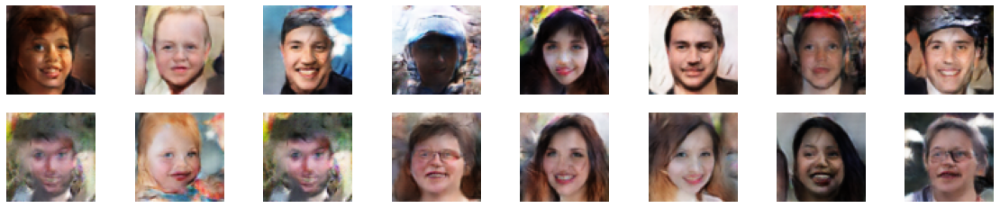

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 21 is 309.64097237586975 sec
Generator loss: 7.296, Discriminator loss: 0.097


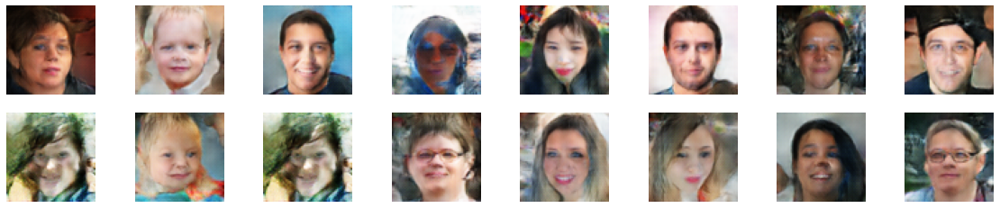

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 22 is 307.955664396286 sec
Generator loss: 7.446, Discriminator loss: 0.096


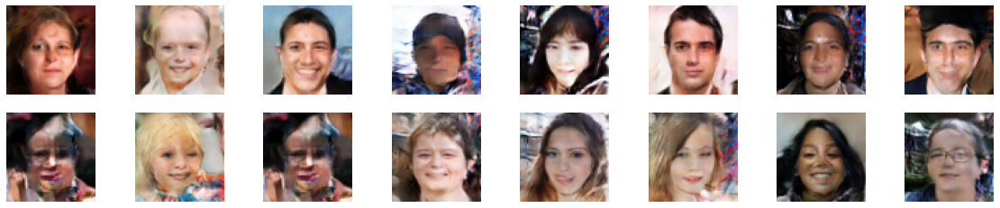

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 23 is 312.1886637210846 sec
Generator loss: 7.434, Discriminator loss: 0.091


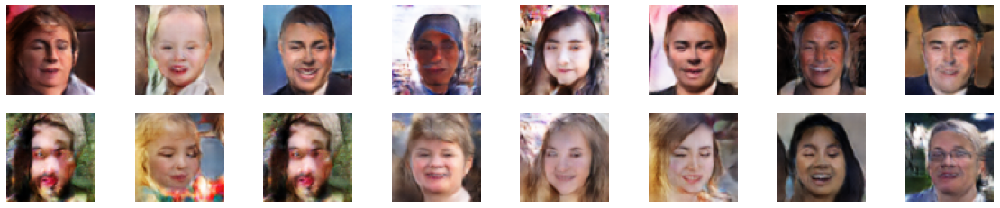

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 24 is 316.6880795955658 sec
Generator loss: 7.542, Discriminator loss: 0.090


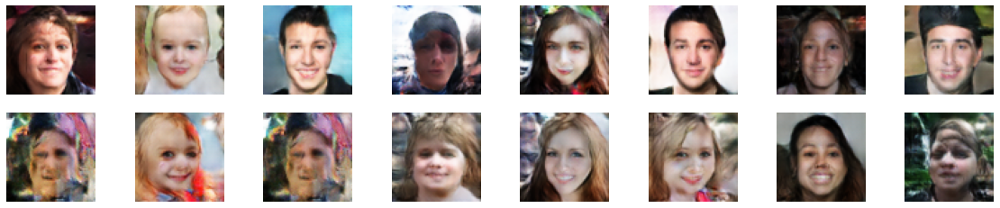

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 25 is 314.0331823825836 sec
Generator loss: 7.652, Discriminator loss: 0.088


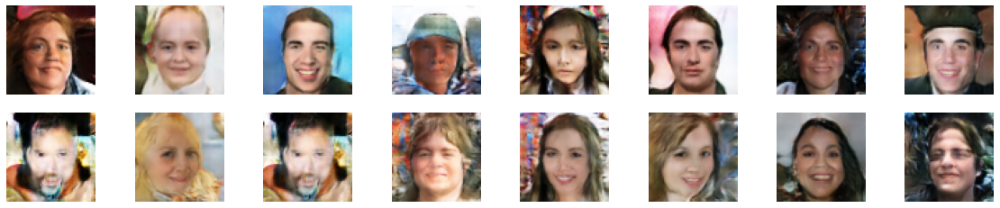

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 26 is 309.65564227104187 sec
Generator loss: 7.504, Discriminator loss: 0.087


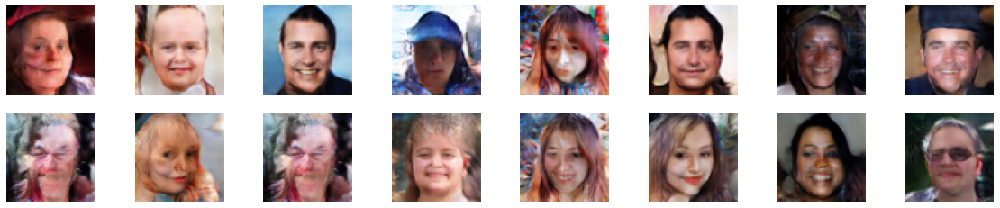

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 27 is 309.9553096294403 sec
Generator loss: 7.663, Discriminator loss: 0.086


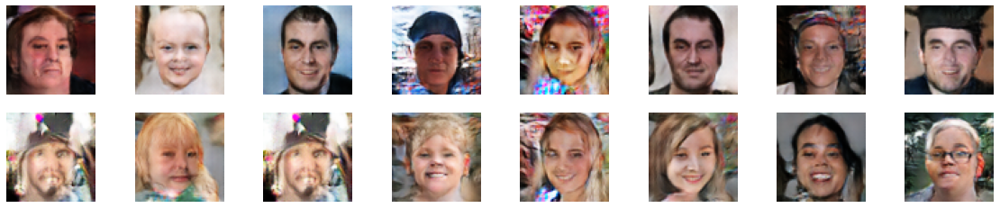

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 28 is 311.039626121521 sec
Generator loss: 7.599, Discriminator loss: 0.090


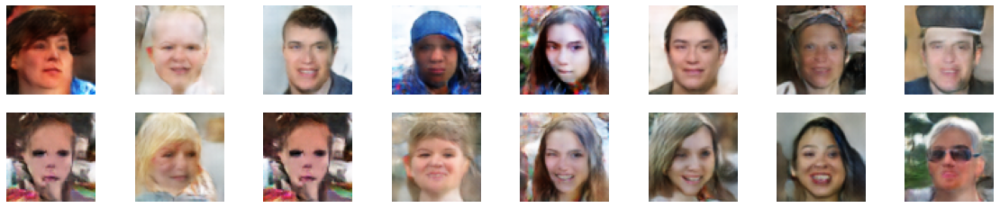

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 29 is 311.3048119544983 sec
Generator loss: 7.549, Discriminator loss: 0.087


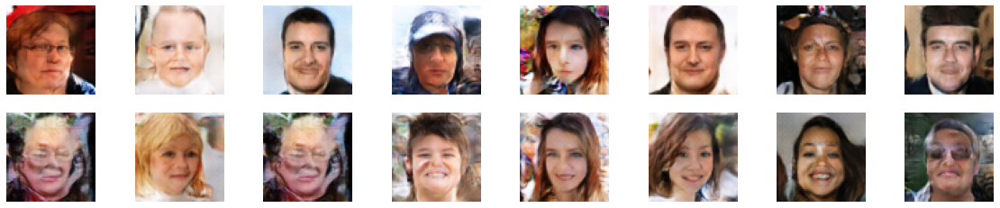

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 30 is 309.9206323623657 sec
Generator loss: 7.763, Discriminator loss: 0.082


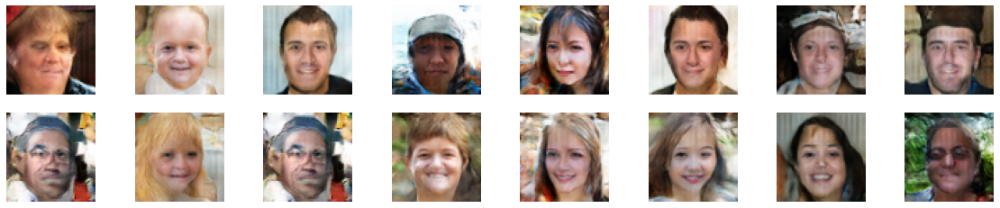

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 31 is 309.04867482185364 sec
Generator loss: 7.715, Discriminator loss: 0.085


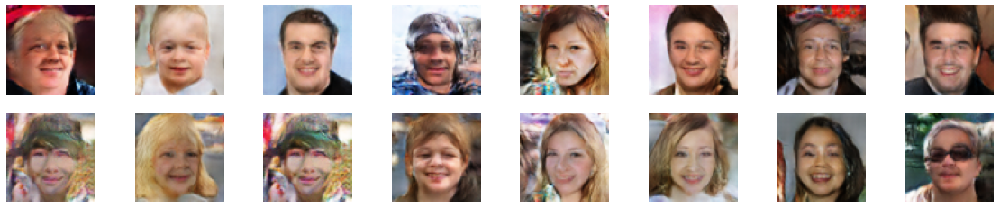

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 32 is 309.9510452747345 sec
Generator loss: 7.671, Discriminator loss: 0.080


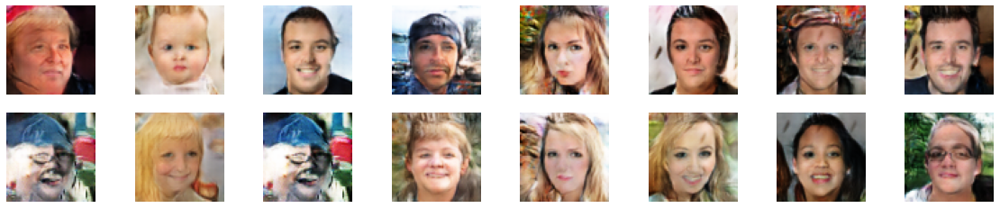

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 33 is 314.81622886657715 sec
Generator loss: 7.678, Discriminator loss: 0.082


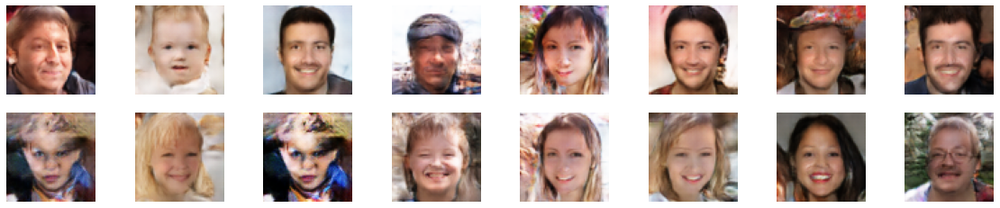

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 34 is 313.2311224937439 sec
Generator loss: 7.614, Discriminator loss: 0.085


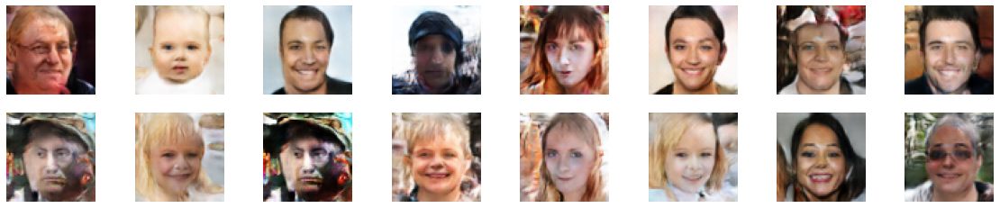

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 35 is 312.56177020072937 sec
Generator loss: 7.758, Discriminator loss: 0.084


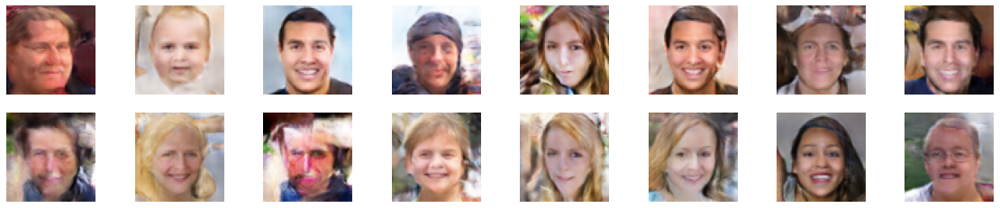

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 36 is 311.61560344696045 sec
Generator loss: 7.751, Discriminator loss: 0.079


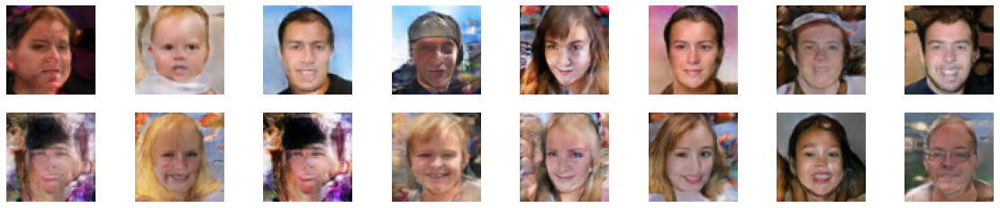

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 37 is 313.4149715900421 sec
Generator loss: 7.990, Discriminator loss: 0.077


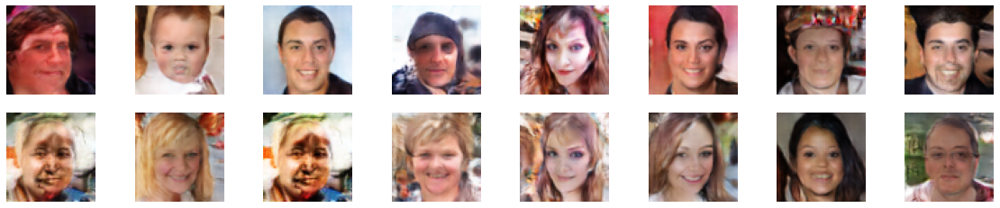

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 38 is 314.7519793510437 sec
Generator loss: 7.720, Discriminator loss: 0.084


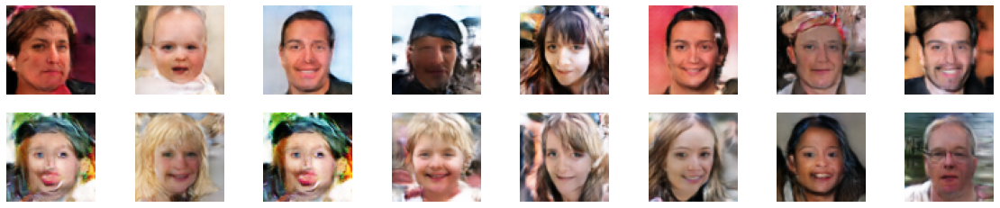

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 39 is 315.11129450798035 sec
Generator loss: 8.009, Discriminator loss: 0.075


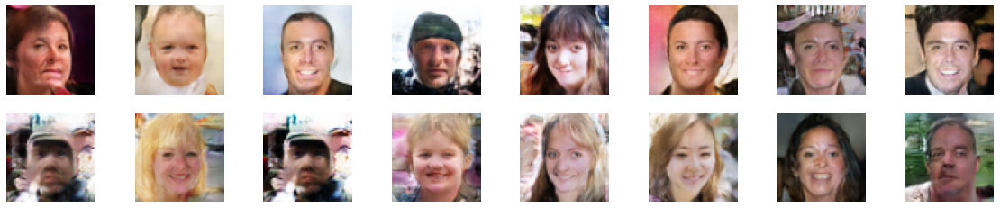

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 40 is 314.54792380332947 sec
Generator loss: 7.930, Discriminator loss: 0.076


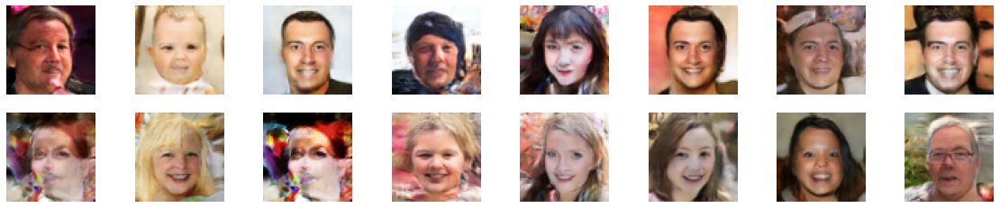

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 41 is 316.2902612686157 sec
Generator loss: 8.164, Discriminator loss: 0.069


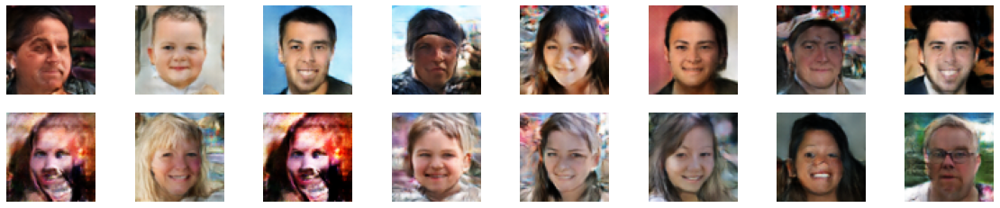

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 42 is 314.83691787719727 sec
Generator loss: 8.219, Discriminator loss: 0.072


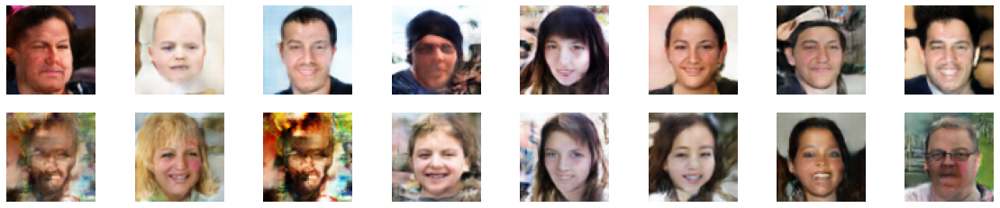

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 43 is 314.44793224334717 sec
Generator loss: 8.116, Discriminator loss: 0.076


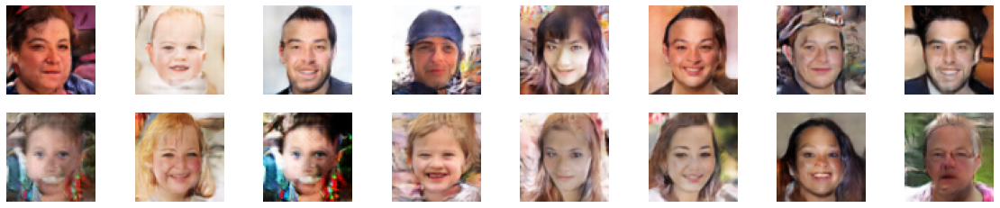

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 44 is 311.21962332725525 sec
Generator loss: 7.927, Discriminator loss: 0.077


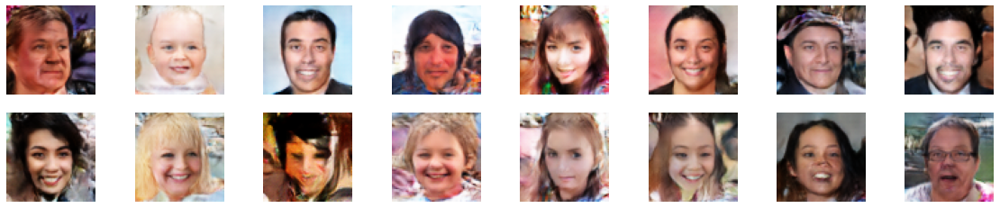

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 45 is 312.3502902984619 sec
Generator loss: 8.020, Discriminator loss: 0.074


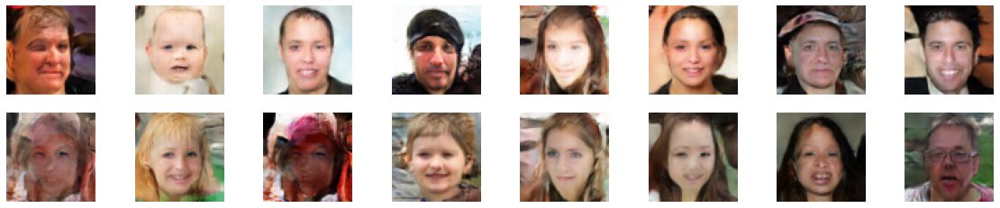

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 46 is 311.712096452713 sec
Generator loss: 8.368, Discriminator loss: 0.070


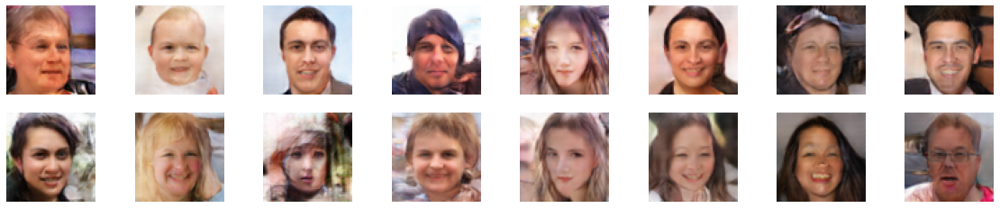

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 47 is 313.28874707221985 sec
Generator loss: 7.987, Discriminator loss: 0.074


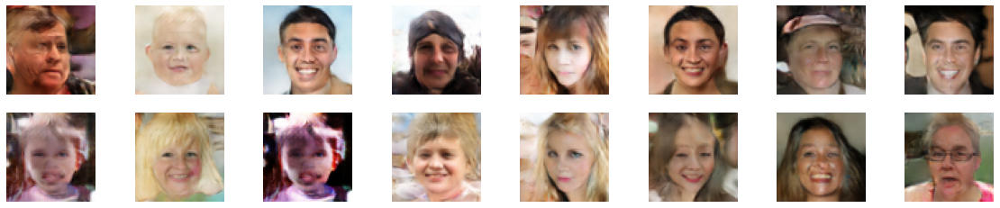

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 48 is 312.9558126926422 sec
Generator loss: 8.161, Discriminator loss: 0.066


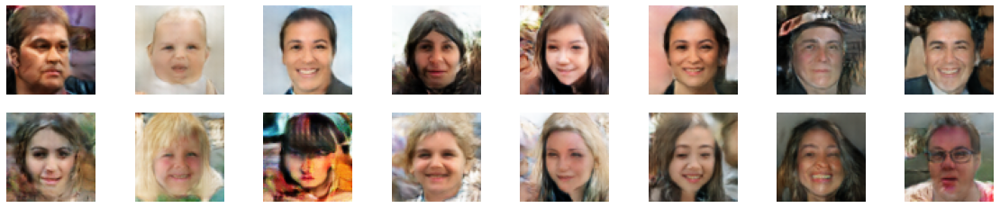

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 49 is 313.6307051181793 sec
Generator loss: 8.320, Discriminator loss: 0.072


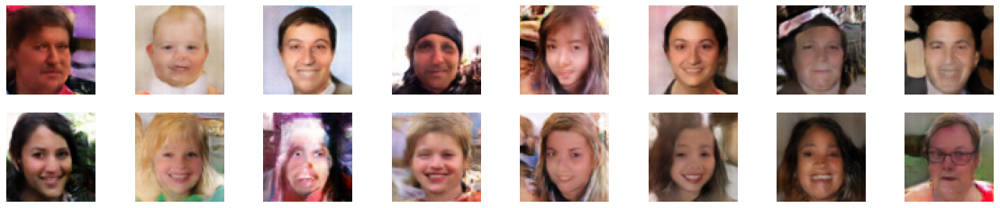

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 50 is 315.2460687160492 sec
Generator loss: 8.137, Discriminator loss: 0.072


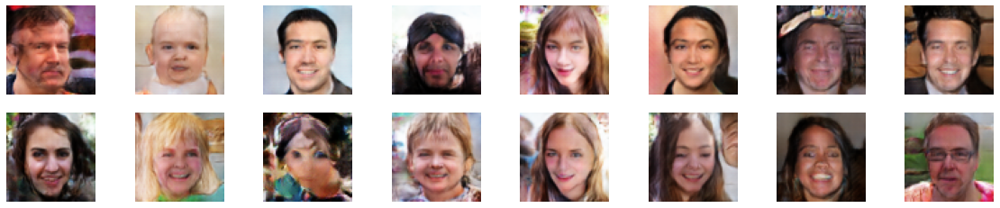

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 51 is 308.8957600593567 sec
Generator loss: 8.231, Discriminator loss: 0.070


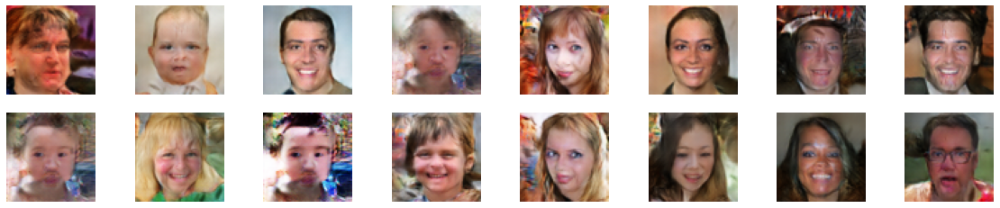

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 52 is 309.12900257110596 sec
Generator loss: 8.309, Discriminator loss: 0.067


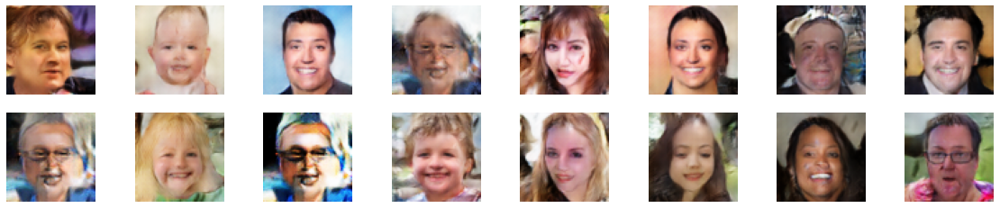

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 53 is 311.69588232040405 sec
Generator loss: 8.422, Discriminator loss: 0.069


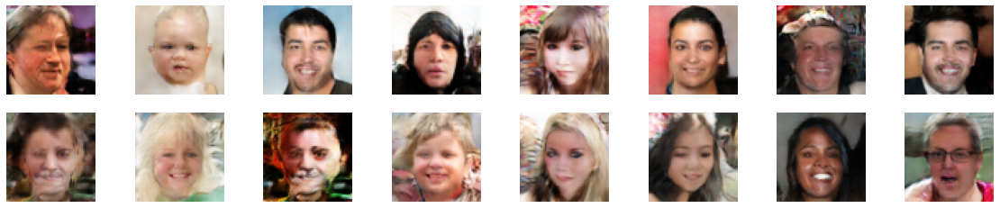

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 54 is 311.91733169555664 sec
Generator loss: 8.187, Discriminator loss: 0.073


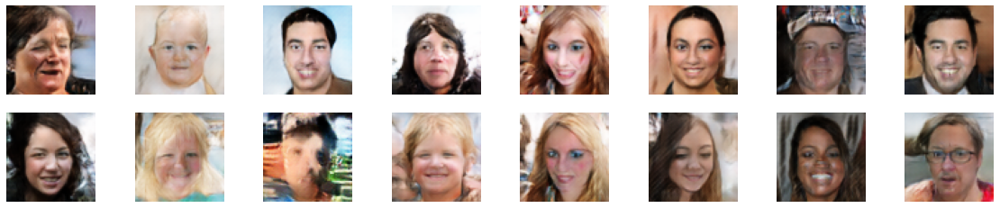

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 55 is 311.00584053993225 sec
Generator loss: 8.049, Discriminator loss: 0.067


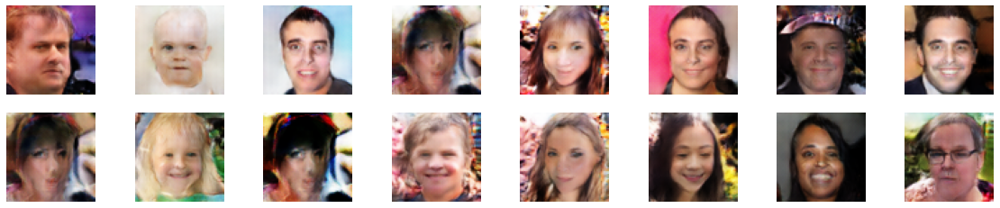

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 56 is 307.6126444339752 sec
Generator loss: 8.376, Discriminator loss: 0.065


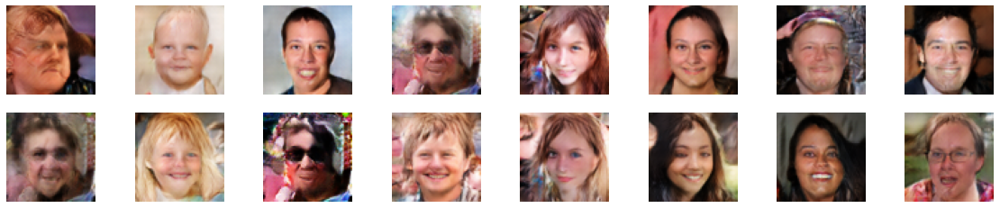

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 57 is 310.8358657360077 sec
Generator loss: 8.479, Discriminator loss: 0.067


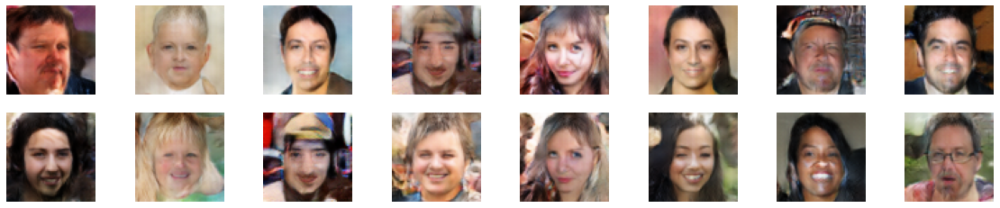

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 58 is 311.4706926345825 sec
Generator loss: 8.441, Discriminator loss: 0.067


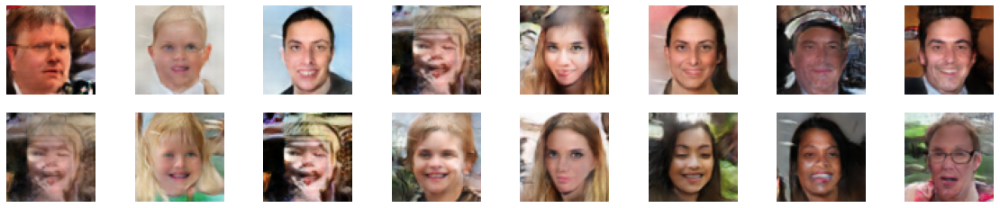

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 59 is 309.4645221233368 sec
Generator loss: 8.438, Discriminator loss: 0.062


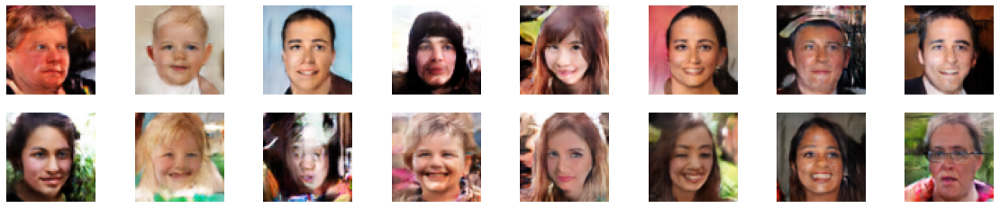

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 60 is 310.4877440929413 sec
Generator loss: 8.508, Discriminator loss: 0.066


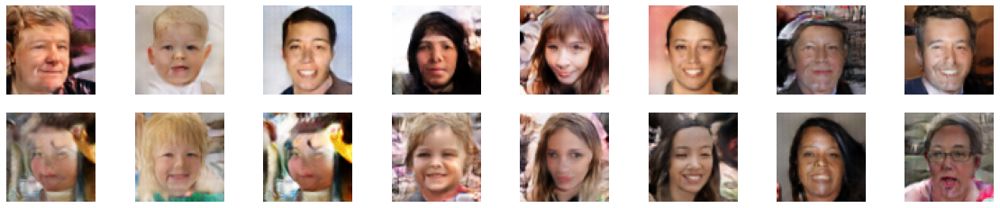

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 61 is 308.399676322937 sec
Generator loss: 8.494, Discriminator loss: 0.069


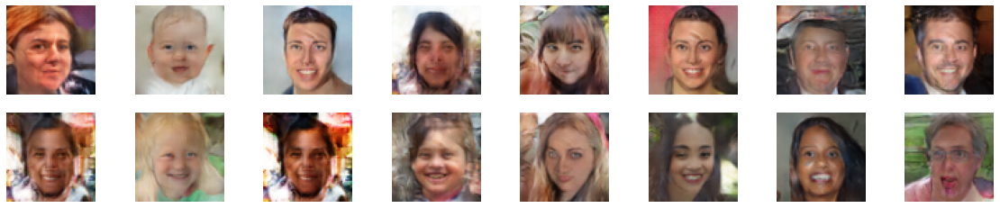

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 62 is 309.63894510269165 sec
Generator loss: 8.431, Discriminator loss: 0.064


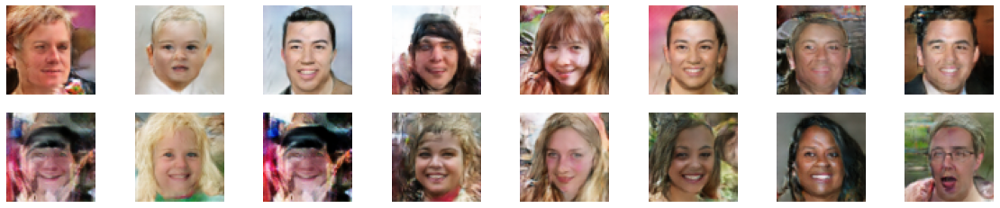

  0%|          | 0/4375 [00:00<?, ?it/s]



Time for epoch 63 is 310.8754470348358 sec
Generator loss: 8.489, Discriminator loss: 0.066


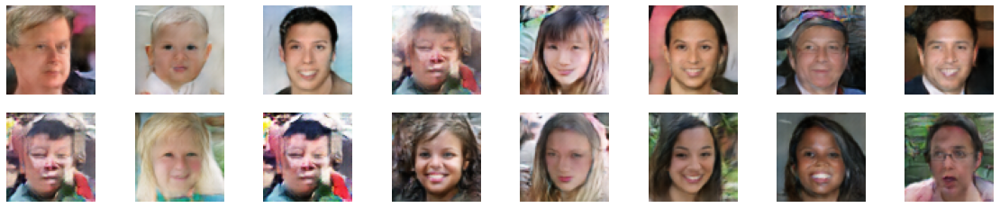

  0%|          | 0/4375 [00:00<?, ?it/s]

In [ ]:
train(train_dataloader, 100)

## 11 Plot the Training Results

In [ ]:
def plot_results(metrics, ylabel=None, ylim=None, metric_name=None, color=None):
    
    fig, ax = plt.subplots(figsize=(18, 5))

    if not (isinstance(metric_name, list) or isinstance(metric_name, tuple)):
        metrics = [metrics,]
        metric_name = [metric_name,]
    
    for idx, metric in enumerate(metrics):    
        ax.plot(metric, color=color[idx])
    
    plt.xlabel("Epoch")
    plt.ylabel(ylabel)
    plt.title(ylabel)
    plt.xlim([0, TrainingConfig.NUM_EPOCHS-1])
    plt.ylim(ylim)
    # Tailor x-axis tick marks
    ax.xaxis.set_major_locator(MultipleLocator(5))
    ax.xaxis.set_major_formatter(FormatStrFormatter('%d'))
    ax.xaxis.set_minor_locator(MultipleLocator(1))
    plt.grid(True)
    plt.legend(metric_name)   
    plt.show(block=block_plot)

In [ ]:
# Retrieve the training results.    
plot_results([G_LOSS, D_LOSS ],        
            ylabel="Loss", 
            ylim=[0, 5],
            metric_name=["Generator Loss", "Discriminator Loss"],
            color=["g", "b"]);

From the plots above, we see that near the beginning, the generator loss is high, and the discriminator loss is low. This makes sense because the generator is trying to figure out how to make plausible images and the discriminator  doesn’t have much difficulty making accurate predictions. As the generator starts to figure things out (even after just 2-3 epochs) the loss generator loss decreases. Noticed that we also see a slight increase in the discriminator loss because it is having more difficulty making accurate predictions. 

But then, after about five epochs the discriminator loss has a very gradual decline, but the generator loss starts to increase, however, this doesn’t necessarily mean that the best images were created after just three or four Epix. If you compare the sample images at 30 epochs with those from around 4-5 epochs, you should notice an overall higher quality after 30 epochs even though the generator loss has more than doubled. In fact, this is one example of why training GANs can be tricky because there is not a clearly defined "stopping" criteria that constitutes the “best” model.

<img src="https://opencv.org/wp-content/uploads/2022/09/c4-gan-dcgan-train-comparison.png">

## 12 Create Images using the Trained Model


In [ ]:
generator = Generator(TrainingConfig.LATENT_DIM)

In [ ]:
trained_generator = torch.load(generator_ckpt)

In [ ]:
print(trained_generator)

In [ ]:
def generate_images(model, noise):
    
    model.eval()
    with torch.no_grad():
        images = model(noise.to(TrainingConfig.DEVICE))
        images = images.detach().cpu()

    plt.figure(figsize=(20, 4))

    nrow = 2
    ncol = int(images.shape[0] / nrow)
    
    for i, image in enumerate(images):
        col = int(TrainingConfig.BATCH_SIZE / 2)
        plt.subplot(nrow, ncol, i+1)
        image = (image.permute(1, 2, 0).squeeze(0) + 1) * 127.5
        plt.imshow(np.array(image).astype('uint8'))
        plt.axis('off')
        
    plt.show();

In [ ]:
noise = torch.randn(
    TrainingConfig.BATCH_SIZE, 
    TrainingConfig.LATENT_DIM,
    1, 1
).to(TrainingConfig.DEVICE)

In [ ]:
generate_images(trained_generator, noise)

## 13 Conclusion

In this notebook, we learned how to implement and train a simple GAN using a CNN to generate faces of people. Some of the generated images shown above look are pretty good while other do not. However, with such a simple DCGAN model, it is very difficult to go past this point. There are more advanced and complex GAN architectures that are available now which can generate HD images of people's faces that are indistinguishable from photographs of real people.